In [1]:
# cat-0 - ICD-9 codes 001–139: infectious and parasitic diseases
# cat-1 - ICD-9 codes 140–239: neoplasms
# cat-2 - ICD-9 codes 240–279: endocrine, nutritional and metabolic diseases, and immunity disorders
# cat-3 - ICD-9 codes 280–289: diseases of the blood and blood-forming organs
# cat-4 - ICD-9 codes 290–319: mental disorders
# cat-5 - ICD-9 codes 320–389: diseases of the nervous system and sense organs
# cat-6 - ICD-9 codes 390–459: diseases of the circulatory system
# cat-7 - ICD-9 codes 460–519: diseases of the respiratory system
# cat-8 - ICD-9 codes 520–579: diseases of the digestive system
# cat-9 - ICD-9 codes 580–629: diseases of the genitourinary system
# cat-10 - ICD-9 codes 630–679: complications of pregnancy, childbirth, and the puerperium
# cat-11 - ICD-9 codes 680–709: diseases of the skin and subcutaneous tissue
# cat-12 - ICD-9 codes 710–739: diseases of the musculoskeletal system and connective tissue
# cat-13 - ICD-9 codes 740–759: congenital anomalies
# cat-14 - ICD-9 codes 760–779: certain conditions originating in the perinatal period
# cat-15 - ICD-9 codes 780–799: symptoms, signs, and ill-defined conditions
# cat-16 - ICD-9 codes 800–999: injury and poisoning
# cat-17 - ICD-9 codes E and V codes: external causes of injury and supplemental classification

# column names for the one hot encoding
column_names = ['INFECTIOUS_PARASITIC_DISEASES', 'NEOPLASMS', 'ENDOCRINE_NUTRITIONAL_METABOLIC_DISEASES',
                'BLOOD_BLOOD_FORMING_ORGANS', 'MENTAL_DISORDERS', 'NERVOUS_SYSTEM_SENSE_ORGANS', 'CIRCULATORY_SYSTEM',
                'RESPIRATORY_SYSTEM', 'DIGESTIVE_SYSTEM', 'GENITOURINARY_SYSTEM', 'PREGNANCY_CHILD_BIRTH_PUERPERIUM', 'SKIN_SUBCUTANEOUS_TISSUE',
                'MUSCULOSKELETAL_CONNECTIVE_TISSUE', 'CONGENITAL_ANOMALIES', 'PERINATAL_PERIOD', 'SYMPTOMS_SIGNS_ILL_DEFINED_CONDITIONS', 'INJURY_POISONING']
# , 'EXTERNAL_SUPPLEMENTAL_CAUSES']
# print('Number of columns:', len(column_names))

odd_stuff = []

# function to return category of a code based on the above categories
def get_cat(code):
    # print(code)
    # print(type(code))

    if code is np.nan or code == 'nan' or code == '' or type(code) == float:
        odd_stuff.append([code, type(code)])
        return np.nan
    
    if code[0] == 'E' or code[0] == 'V':
        return 'cat17'
    
    if code is not np.nan:
        try:
            code = int(code)
        except ValueError:
            return -1
        # code = int(code)
        if code >= 1 and code <= 139:
            return 'cat0'
        elif code >= 140 and code <= 239:
            return 'cat1'
        elif code >= 240 and code <= 279:
            return 'cat2'
        elif code >= 280 and code <= 289:
            return 'cat3'
        elif code >= 290 and code <= 319:
            return 'cat4'
        elif code >= 320 and code <= 389:
            return 'cat5'
        elif code >= 390 and code <= 459:
            return 'cat6'
        elif code >= 460 and code <= 519:
            return 'cat7'
        elif code >= 520 and code <= 579:
            return 'cat8'
        elif code >= 580 and code <= 629:
            return 'cat9'
        elif code >= 630 and code <= 679:
            return 'cat10'
        elif code >= 680 and code <= 709:
            return 'cat11'
        elif code >= 710 and code <= 739:
            return 'cat12'
        elif code >= 740 and code <= 759:
            return 'cat13'
        elif code >= 760 and code <=779:
            return 'cat14'
        elif code >=780 and code <=799:
            return 'cat15'
        elif code >=800 and code <=999:
            return 'cat16'
    else:
        return -1
    


def one_hot_encode(codes):
    # create a list of zeros for each category
    categories = [0] * 17
    # loop through the codes and set the corresponding category to 1
    for code in codes:
        # check if code is not nan and is a number
        if code is not np.nan:
            # check if code is a number and convert to int  
            try:
                code = int(code)
            except ValueError:
                continue
            # code = int(code)
            if code >= 1 and code <= 139:
                categories[0] = 1
            elif code >= 140 and code <= 239:
                categories[1] = 1
            elif code >= 240 and code <= 279:
                categories[2] = 1
            elif code >= 280 and code <= 289:
                categories[3] = 1
            elif code >= 290 and code <= 319:
                categories[4] = 1
            elif code >= 320 and code <= 389:
                categories[5] = 1
            elif code >= 390 and code <= 459:
                categories[6] = 1
            elif code >= 460 and code <= 519:
                categories[7] = 1
            elif code >= 520 and code <= 579:
                categories[8] = 1
            elif code >= 580 and code <= 629:
                categories[9] = 1
            elif code >= 630 and code <= 679:
                categories[10] = 1
            elif code >= 680 and code <= 709:
                categories[11] = 1
            elif code >= 710 and code <= 739:
                categories[12] = 1
            elif code >= 740 and code <= 759:
                categories[13] = 1
            elif code >= 760 and code <=779:
                categories[14] = 1
            elif code >=780 and code <=799:
                categories[15] = 1
            elif (code>=800) or (code<=999):
                categories[16] =1

    return categories

In [4]:
# new format where every icd code is a column and marked either 1 or 0 - including all related ICD codes per visit (rather than just the first three)
# includes top icd as a category (0-17) based on the category of the code   
# excludes the E and V codes
# also disinclude the patients with more than 10 visits and normalise the dates such that first visit date is 2000-01-01

import pandas as pd
import numpy as np
from datetime import datetime

# load data
admissions = pd.read_csv('ADMISSIONS.csv')
dcodes = pd.read_csv('DIAGNOSES_ICD.csv')
patients = pd.read_csv('PATIENTS.csv')

# get all subject IDs
subject_ids = admissions['SUBJECT_ID'].unique()
print('Number of subjects:', len(subject_ids))

over3visits = 0
less10visits = 0            # only these for now
lessthan3visits = 0
codelessvisitpatients = 0   # number of patients with at least one visit with no codes amd thus not included in the dataset
totalpatients = len(subject_ids)
currentpatient = 0

num_of_codes = 3  # number of codes per visit to include in the context
record_list = []
visits_distribution = []

new_first_visit_date = datetime.strptime('2000-01-01', '%Y-%m-%d')

dob_flag = 0

# create records per visit for each patient
for subject_id in subject_ids:
    currentpatient += 1

    # get all visits for this subject
    visits = admissions[admissions['SUBJECT_ID'] == subject_id]
    print('Number of visits for subject ID', subject_id, ':', len(visits))
    # skip if number of visits is less than 3
    if len(visits) < 3:
        lessthan3visits += 1
        continue
    over3visits += 1
    # skip if number of visits is more than 10
    if len(visits) > 10:
        continue
    less10visits += 1

    # get patient meta data from PATIENTS.csv
    patient = patients[patients['SUBJECT_ID'] == subject_id].iloc[0]
    print('Patient details:', patient)
    # get just the date section of the dob
    dob = patient['DOB']
    dob = dob.split(' ')[0]

    # if dob is in the 1800s, set flag
    if dob[0:2] == '18' or dob[0:2] == '19':
        dob_flag = 1

    # add to visits distribution
    visits_distribution.append(len(visits))

    # sort visits by admit time
    visits = visits.sort_values(by='ADMITTIME')
    visits = visits.reset_index(drop=True) 
    
    # first visit date
    first_visit = visits.iloc[0]
    first_visit_date = datetime.strptime(first_visit['ADMITTIME'], '%Y-%m-%d %H:%M:%S')

    # normalise the dob to the first visit date
    if dob_flag == 0:
        dob = datetime.strptime(dob, '%Y-%m-%d')
        difference = first_visit_date - dob
        dob = new_first_visit_date - difference
        dob = dob.strftime('%Y-%m-%d')
    elif dob_flag == 1:
        # set date to 1910-01-01
        dob = datetime.strptime('1910-01-01', '%Y-%m-%d')
        dob = dob.strftime('%Y-%m-%d')
        dob_flag = 0

    # for each visit, create a record in a dataframe
    for i in range(len(visits)):
        visit = visits.iloc[i]
        
        if i == 0:
            visit_date = new_first_visit_date.strftime('%Y-%m-%d')
        else:
            visit_date = datetime.strptime(visit['ADMITTIME'], '%Y-%m-%d %H:%M:%S')
            visit_date = visit_date.strftime('%Y-%m-%d')
            # normalise the visit date to the first visit date
            visit_date = datetime.strptime(visit_date, '%Y-%m-%d')
            difference = visit_date - first_visit_date
            visit_date = new_first_visit_date + difference
            visit_date = visit_date.strftime('%Y-%m-%d')

        
        # visit code stuff
        visit_id = visit['HADM_ID']
        visit_codes = dcodes[dcodes['HADM_ID'] == visit_id]['ICD9_CODE']
        # check if there are any nan values in the visit_codes
        if visit_codes.isnull().values.any():
            print('Nan values found in visit codes')
            # remove all records in list for this patient
            record_list = [record for record in record_list if record[0] != subject_id]
            codelessvisitpatients += 1
            break
        
        print(len(visit_codes))
        # check if there are less than 3 codes and if so, add nan values
        if len(visit_codes) < num_of_codes:
            for j in range(num_of_codes - len(visit_codes)):
                # visit_codes = visit_codes(, ignore_index=True)
                visit_codes = pd.concat([visit_codes, pd.Series(np.nan)], ignore_index=True)

        # get the first three chars of visit_codes.iloc[0]
        visit_codes = visit_codes.str[:3]

        # one hot encode the visit codes
        visit_codes_ohe = one_hot_encode(visit_codes)
        print(visit_codes_ohe)

        # get the first three chars of visit_codes.iloc[0]
        visit_codes_short = visit_codes.str[:3]

        # get the category of the visit codes
        visit_codes_cats = visit_codes_short.apply(get_cat)
        print(visit_codes_cats)

        # append record to list
        print(visit['HADM_ID'], subject_id, patient['GENDER'], dob, visit_date, visit_codes_cats.iloc[0], visit_codes_ohe)
        record = [visit['HADM_ID'], subject_id, patient['GENDER'], dob, visit_date, visit_codes_cats.iloc[0]]
        # append visit_codes_ohe to record
        record.extend(visit_codes_ohe)
        record_list.append(record)
        # print(record_list)

# convert list to pd dataframe and save to csv
df = pd.DataFrame(record_list, columns=['HADM_ID', 'SUBJECT_ID', 'GENDER', 'DOB', 'DATE', 'TOP_ICD', 'INFECTIOUS_PARASITIC_DISEASES', 'NEOPLASMS', 
                                        'ENDOCRINE_NUTRITIONAL_METABOLIC_DISEASES', 'BLOOD_BLOOD_FORMING_ORGANS', 'MENTAL_DISORDERS', 
                                        'NERVOUS_SYSTEM_SENSE_ORGANS', 'CIRCULATORY_SYSTEM', 'RESPIRATORY_SYSTEM', 'DIGESTIVE_SYSTEM', 
                                        'GENITOURINARY_SYSTEM', 'PREGNANCY_CHILD_BIRTH_PUERPERIUM', 'SKIN_SUBCUTANEOUS_TISSUE', 'MUSCULOSKELETAL_CONNECTIVE_TISSUE', 
                                        'CONGENITAL_ANOMALIES', 'PERINATAL_PERIOD', 'SYMPTOMS_SIGNS_ILL_DEFINED_CONDITIONS', 'INJURY_POISONING'])
print(df)
df.to_csv('new_records_per_visit_ohe_and_cat.csv', index=False)
    
print(df)
print('Number of subjects with over 3 visits:', over3visits)

Number of subjects: 46520
Number of visits for subject ID 22 : 1
Number of visits for subject ID 23 : 2
Number of visits for subject ID 24 : 1
Number of visits for subject ID 25 : 1
Number of visits for subject ID 26 : 1
Number of visits for subject ID 27 : 1
Number of visits for subject ID 28 : 1
Number of visits for subject ID 30 : 1
Number of visits for subject ID 31 : 1
Number of visits for subject ID 32 : 1
Number of visits for subject ID 33 : 1
Number of visits for subject ID 34 : 2
Number of visits for subject ID 35 : 1
Number of visits for subject ID 36 : 3
Patient details: ROW_ID                          32
SUBJECT_ID                      36
GENDER                           M
DOB            2061-08-17 00:00:00
DOD                            NaN
DOD_HOSP                       NaN
DOD_SSN                        NaN
EXPIRE_FLAG                      0
Name: 253, dtype: object
9
[0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0]
894     cat6
895     cat6
896     cat7
897     cat6


KeyboardInterrupt: 

0        2075-03-13 00:00:00
1        2164-12-27 00:00:00
2        2090-03-15 00:00:00
3        2078-03-06 00:00:00
4        2089-11-26 00:00:00
                ...         
46515    2026-05-25 00:00:00
46516    2124-07-27 00:00:00
46517    2049-11-26 00:00:00
46518    2076-07-25 00:00:00
46519    2098-07-25 00:00:00
Name: DOB, Length: 46520, dtype: object
DOB
20    22501
21    21903
18     1959
22      125
19       32
Name: count, dtype: int64


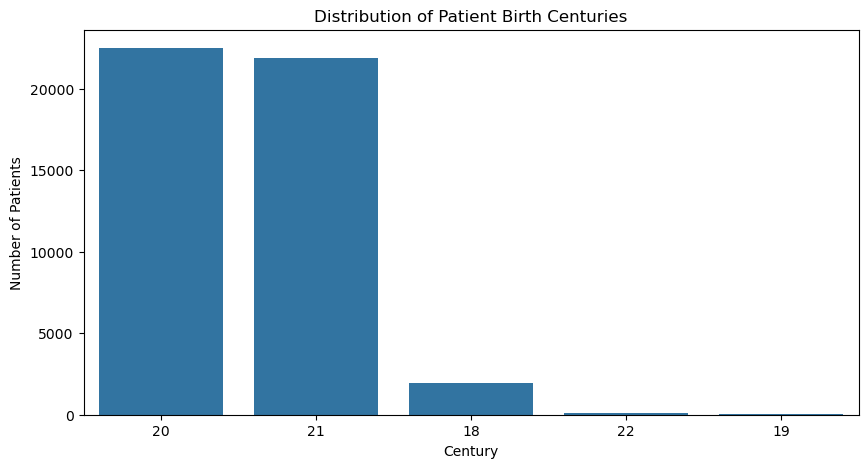

In [ ]:
# plot distibution of patient birth centuries
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

patients = pd.read_csv('PATIENTS.csv')
# get the dob column from the patients dataframe
dob = patients['DOB']
print(dob)
# get the first two chars of the dob column
dob = dob.str[:2]
# count the number of patients in each century
dob_counts = dob.value_counts()
print(dob_counts)
# plot the counts
plt.figure(figsize=(10, 5))
sns.countplot(x=dob, data=patients)
plt.title('Distribution of Patient Birth Centuries')
plt.xlabel('Century')
plt.ylabel('Number of Patients')
plt.show()

In [ ]:
# new format where every icd code is a column and marked either 1 or 0 - including all related ICD codes per visit (rather than just the first three)
# excludes the E and V codes
# also disinclude the patients with more than 10 visits and normalise the dates such that first visit date is 2000-01-01

import pandas as pd
import numpy as np
from datetime import datetime

# load data
admissions = pd.read_csv('ADMISSIONS.csv')
dcodes = pd.read_csv('DIAGNOSES_ICD.csv')
patients = pd.read_csv('PATIENTS.csv')

# get all subject IDs
subject_ids = admissions['SUBJECT_ID'].unique()
print('Number of subjects:', len(subject_ids))

over3visits = 0
less10visits = 0            # only these for now
lessthan3visits = 0
codelessvisitpatients = 0   # number of patients with at least one visit with no codes amd thus not included in the dataset
totalpatients = len(subject_ids)
currentpatient = 0

num_of_codes = 3  # number of codes per visit to include in the context
record_list = []
visits_distribution = []

new_first_visit_date = datetime.strptime('2000-01-01', '%Y-%m-%d')

dob_flag = 0

# create records per visit for each patient
for subject_id in subject_ids:
    currentpatient += 1

    # get all visits for this subject
    visits = admissions[admissions['SUBJECT_ID'] == subject_id]
    print('Number of visits for subject ID', subject_id, ':', len(visits))
    # skip if number of visits is less than 3
    if len(visits) < 3:
        lessthan3visits += 1
        continue
    over3visits += 1
    # skip if number of visits is more than 10
    if len(visits) > 10:
        continue
    less10visits += 1

    # get patient meta data from PATIENTS.csv
    patient = patients[patients['SUBJECT_ID'] == subject_id].iloc[0]
    print('Patient details:', patient)
    # get just the date section of the dob
    dob = patient['DOB']
    dob = dob.split(' ')[0]

    # if dob is in the 1800s, set flag
    if dob[0:2] == '18' or dob[0:2] == '19':
        dob_flag = 1

    # add to visits distribution
    visits_distribution.append(len(visits))

    # sort visits by admit time
    visits = visits.sort_values(by='ADMITTIME')
    visits = visits.reset_index(drop=True) 
    
    # first visit date
    first_visit = visits.iloc[0]
    first_visit_date = datetime.strptime(first_visit['ADMITTIME'], '%Y-%m-%d %H:%M:%S')

    # normalise the dob to the first visit date
    if dob_flag == 0:
        dob = datetime.strptime(dob, '%Y-%m-%d')
        difference = first_visit_date - dob
        dob = new_first_visit_date - difference
        dob = dob.strftime('%Y-%m-%d')
    elif dob_flag == 1:
        # set date to 1910-01-01
        dob = datetime.strptime('1910-01-01', '%Y-%m-%d')
        dob = dob.strftime('%Y-%m-%d')
        dob_flag = 0

    # for each visit, create a record in a dataframe
    for i in range(len(visits)):
        visit = visits.iloc[i]
        
        if i == 0:
            visit_date = new_first_visit_date.strftime('%Y-%m-%d')
        else:
            visit_date = datetime.strptime(visit['ADMITTIME'], '%Y-%m-%d %H:%M:%S')
            visit_date = visit_date.strftime('%Y-%m-%d')
            # normalise the visit date to the first visit date
            visit_date = datetime.strptime(visit_date, '%Y-%m-%d')
            difference = visit_date - first_visit_date
            visit_date = new_first_visit_date + difference
            visit_date = visit_date.strftime('%Y-%m-%d')

        
        # visit code stuff
        visit_id = visit['HADM_ID']
        visit_codes = dcodes[dcodes['HADM_ID'] == visit_id]['ICD9_CODE']
        # check if there are any nan values in the visit_codes
        if visit_codes.isnull().values.any():
            print('Nan values found in visit codes')
            # remove all records in list for this patient
            record_list = [record for record in record_list if record[0] != subject_id]
            codelessvisitpatients += 1
            break
        
        print(len(visit_codes))
        # check if there are less than 3 codes and if so, add nan values
        if len(visit_codes) < num_of_codes:
            for j in range(num_of_codes - len(visit_codes)):
                # visit_codes = visit_codes(, ignore_index=True)
                visit_codes = pd.concat([visit_codes, pd.Series(np.nan)], ignore_index=True)

        # get the first three chars of visit_codes.iloc[0]
        visit_codes = visit_codes.str[:3]

        # one hot encode the visit codes
        visit_codes_ohe = one_hot_encode(visit_codes)
        print(visit_codes_ohe)

        # append record to list
        print(visit['HADM_ID'], subject_id, patient['GENDER'], dob, visit_date, visit_codes_ohe)
        record = [visit['HADM_ID'], subject_id, patient['GENDER'], dob, visit_date]
        # append visit_codes_ohe to record
        record.extend(visit_codes_ohe)
        record_list.append(record)
        # print(record_list)

# convert list to pd dataframe and save to csv
df = pd.DataFrame(record_list, columns=['HADM_ID', 'SUBJECT_ID', 'GENDER', 'DOB', 'DATE', 'INFECTIOUS_PARASITIC_DISEASES', 'NEOPLASMS', 
                                        'ENDOCRINE_NUTRITIONAL_METABOLIC_DISEASES', 'BLOOD_BLOOD_FORMING_ORGANS', 'MENTAL_DISORDERS', 
                                        'NERVOUS_SYSTEM_SENSE_ORGANS', 'CIRCULATORY_SYSTEM', 'RESPIRATORY_SYSTEM', 'DIGESTIVE_SYSTEM', 
                                        'GENITOURINARY_SYSTEM', 'PREGNANCY_CHILD_BIRTH_PUERPERIUM', 'SKIN_SUBCUTANEOUS_TISSUE', 'MUSCULOSKELETAL_CONNECTIVE_TISSUE', 
                                        'CONGENITAL_ANOMALIES', 'PERINATAL_PERIOD', 'SYMPTOMS_SIGNS_ILL_DEFINED_CONDITIONS', 'INJURY_POISONING'])
print(df)
df.to_csv('records_per_visit_ohe3.csv', index=False)
    
print(df)
print('Number of subjects with over 3 visits:', over3visits)

Number of subjects: 46520
Number of visits for subject ID 22 : 1
Number of visits for subject ID 23 : 2
Number of visits for subject ID 24 : 1
Number of visits for subject ID 25 : 1
Number of visits for subject ID 26 : 1
Number of visits for subject ID 27 : 1
Number of visits for subject ID 28 : 1
Number of visits for subject ID 30 : 1
Number of visits for subject ID 31 : 1
Number of visits for subject ID 32 : 1
Number of visits for subject ID 33 : 1
Number of visits for subject ID 34 : 2
Number of visits for subject ID 35 : 1
Number of visits for subject ID 36 : 3
Patient details: ROW_ID                          32
SUBJECT_ID                      36
GENDER                           M
DOB            2061-08-17 00:00:00
DOD                            NaN
DOD_HOSP                       NaN
DOD_SSN                        NaN
EXPIRE_FLAG                      0
Name: 253, dtype: object
9
[0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0]
182104 36 M 1930-04-20 2000-01-01 [0, 0, 0, 0, 1, 0,

In [ ]:
# new format where every icd code is a column and marked either 1 or 0 - including all related ICD codes per visit (rather than just the first three)
# includes top icd as the first three chars of the code  
# excludes the E and V codes
# also disinclude the patients with more than 10 visits and normalise the dates such that first visit date is 2000-01-01

import pandas as pd
import numpy as np
from datetime import datetime

# load data
admissions = pd.read_csv('ADMISSIONS.csv')
dcodes = pd.read_csv('DIAGNOSES_ICD.csv')
patients = pd.read_csv('PATIENTS.csv')

# get all subject IDs
subject_ids = admissions['SUBJECT_ID'].unique()
print('Number of subjects:', len(subject_ids))

over3visits = 0
less10visits = 0            # only these for now
lessthan3visits = 0
codelessvisitpatients = 0   # number of patients with at least one visit with no codes amd thus not included in the dataset
totalpatients = len(subject_ids)
currentpatient = 0

num_of_codes = 3  # number of codes per visit to include in the context
record_list = []
visits_distribution = []

new_first_visit_date = datetime.strptime('2000-01-01', '%Y-%m-%d')

dob_flag = 0

# create records per visit for each patient
for subject_id in subject_ids:
    currentpatient += 1

    # get all visits for this subject
    visits = admissions[admissions['SUBJECT_ID'] == subject_id]
    print('Number of visits for subject ID', subject_id, ':', len(visits))
    # skip if number of visits is less than 3
    if len(visits) < 3:
        lessthan3visits += 1
        continue
    over3visits += 1
    # skip if number of visits is more than 10
    if len(visits) > 10:
        continue
    less10visits += 1

    # get patient meta data from PATIENTS.csv
    patient = patients[patients['SUBJECT_ID'] == subject_id].iloc[0]
    print('Patient details:', patient)
    # get just the date section of the dob
    dob = patient['DOB']
    dob = dob.split(' ')[0]

    # if dob is in the 1800s, set flag
    if dob[0:2] == '18' or dob[0:2] == '19':
        dob_flag = 1

    # add to visits distribution
    visits_distribution.append(len(visits))

    # sort visits by admit time
    visits = visits.sort_values(by='ADMITTIME')
    visits = visits.reset_index(drop=True) 
    
    # first visit date
    first_visit = visits.iloc[0]
    first_visit_date = datetime.strptime(first_visit['ADMITTIME'], '%Y-%m-%d %H:%M:%S')

    # normalise the dob to the first visit date
    if dob_flag == 0:
        dob = datetime.strptime(dob, '%Y-%m-%d')
        difference = first_visit_date - dob
        dob = new_first_visit_date - difference
        dob = dob.strftime('%Y-%m-%d')
    elif dob_flag == 1:
        # set date to 1910-01-01
        dob = datetime.strptime('1910-01-01', '%Y-%m-%d')
        dob = dob.strftime('%Y-%m-%d')
        dob_flag = 0

    # for each visit, create a record in a dataframe
    for i in range(len(visits)):
        visit = visits.iloc[i]
        
        if i == 0:
            visit_date = new_first_visit_date.strftime('%Y-%m-%d')
        else:
            visit_date = datetime.strptime(visit['ADMITTIME'], '%Y-%m-%d %H:%M:%S')
            visit_date = visit_date.strftime('%Y-%m-%d')
            # normalise the visit date to the first visit date
            visit_date = datetime.strptime(visit_date, '%Y-%m-%d')
            difference = visit_date - first_visit_date
            visit_date = new_first_visit_date + difference
            visit_date = visit_date.strftime('%Y-%m-%d')

        
        # visit code stuff
        visit_id = visit['HADM_ID']
        visit_codes = dcodes[dcodes['HADM_ID'] == visit_id]['ICD9_CODE']
        # check if there are any nan values in the visit_codes
        if visit_codes.isnull().values.any():
            print('Nan values found in visit codes')
            # remove all records in list for this patient
            record_list = [record for record in record_list if record[0] != subject_id]
            codelessvisitpatients += 1
            break
        
        print(len(visit_codes))
        # check if there are less than 3 codes and if so, add nan values
        if len(visit_codes) < num_of_codes:
            for j in range(num_of_codes - len(visit_codes)):
                # visit_codes = visit_codes(, ignore_index=True)
                visit_codes = pd.concat([visit_codes, pd.Series(np.nan)], ignore_index=True)

        # get the first three chars of visit_codes.iloc[0]
        visit_codes = visit_codes.str[:3]

        # one hot encode the visit codes
        visit_codes_ohe = one_hot_encode(visit_codes)
        print(visit_codes_ohe)

        # get the first three chars of visit_codes.iloc[0]
        visit_codes_short = visit_codes.str[:3]

        # get the category of the visit codes
        # visit_codes_cats = visit_codes_short.apply(get_cat)
        # print(visit_codes_cats)

        # append record to list
        print(visit['HADM_ID'], subject_id, patient['GENDER'], dob, visit_date, visit_codes_short.iloc[0], visit_codes_ohe)
        record = [visit['HADM_ID'], subject_id, patient['GENDER'], dob, visit_date, visit_codes_short.iloc[0]]
        # append visit_codes_ohe to record
        record.extend(visit_codes_ohe)
        record_list.append(record)
        # print(record_list)

# convert list to pd dataframe and save to csv
df = pd.DataFrame(record_list, columns=['HADM_ID', 'SUBJECT_ID', 'GENDER', 'DOB', 'DATE', 'TOP_ICD', 'INFECTIOUS_PARASITIC_DISEASES', 'NEOPLASMS', 
                                        'ENDOCRINE_NUTRITIONAL_METABOLIC_DISEASES', 'BLOOD_BLOOD_FORMING_ORGANS', 'MENTAL_DISORDERS', 
                                        'NERVOUS_SYSTEM_SENSE_ORGANS', 'CIRCULATORY_SYSTEM', 'RESPIRATORY_SYSTEM', 'DIGESTIVE_SYSTEM', 
                                        'GENITOURINARY_SYSTEM', 'PREGNANCY_CHILD_BIRTH_PUERPERIUM', 'SKIN_SUBCUTANEOUS_TISSUE', 'MUSCULOSKELETAL_CONNECTIVE_TISSUE', 
                                        'CONGENITAL_ANOMALIES', 'PERINATAL_PERIOD', 'SYMPTOMS_SIGNS_ILL_DEFINED_CONDITIONS', 'INJURY_POISONING'])
print(df)
df.to_csv('new_records_per_visit_ohe_and_icd3char.csv', index=False)
    
print(df)
print('Number of subjects with over 3 visits:', over3visits)

In [ ]:
# for process mining
# include patients with 2 visits and all above
# remove recurrent icd visits.
# new format where every icd code is a column and marked either 1 or 0 - including all related ICD codes per visit (rather than just the first three)
# includes top icd as the first three chars of the code  
# excludes the E and V codes
# normalise the dates such that first visit date is 2000-01-01

import pandas as pd
import numpy as np
from datetime import datetime

# load data
admissions = pd.read_csv('ADMISSIONS.csv')
dcodes = pd.read_csv('DIAGNOSES_ICD.csv')
patients = pd.read_csv('PATIENTS.csv')

# get all subject IDs
subject_ids = admissions['SUBJECT_ID'].unique()
print('Number of subjects:', len(subject_ids))

over2visits = 0
less10visits = 0            # only these for now
lessthan2visits = 0
codelessvisitpatients = 0   # number of patients with at least one visit with no codes amd thus not included in the dataset
totalpatients = len(subject_ids)
currentpatient = 0

num_of_codes = 3  # number of codes per visit to include in the context
record_list = []
visits_distribution = []

new_first_visit_date = datetime.strptime('2000-01-01', '%Y-%m-%d')

dob_flag = 0
carry_forward_icd = ''

# create records per visit for each patient
for subject_id in subject_ids:
    currentpatient += 1

    # get all visits for this subject
    visits = admissions[admissions['SUBJECT_ID'] == subject_id]
    print('Number of visits for subject ID', subject_id, ':', len(visits))
    # skip if number of visits is less than 3
    if len(visits) < 2:
        lessthan2visits += 1
        continue
    over2visits += 1
    # skip if number of visits is more than 10
    # if len(visits) > 10:
    #     continue
    # less10visits += 1

    # get patient meta data from PATIENTS.csv
    patient = patients[patients['SUBJECT_ID'] == subject_id].iloc[0]
    print('Patient details:', patient)
    # get just the date section of the dob
    dob = patient['DOB']
    dob = dob.split(' ')[0]

    # if dob is in the 1800s, set flag
    if dob[0:2] == '18' or dob[0:2] == '19':
        dob_flag = 1

    # add to visits distribution
    visits_distribution.append(len(visits))

    # sort visits by admit time
    visits = visits.sort_values(by='ADMITTIME')
    visits = visits.reset_index(drop=True) 
    
    # first visit date
    first_visit = visits.iloc[0]
    first_visit_date = datetime.strptime(first_visit['ADMITTIME'], '%Y-%m-%d %H:%M:%S')

    # normalise the dob to the first visit date
    if dob_flag == 0:
        dob = datetime.strptime(dob, '%Y-%m-%d')
        difference = first_visit_date - dob
        dob = new_first_visit_date - difference
        dob = dob.strftime('%Y-%m-%d')
    elif dob_flag == 1:
        # set date to 1910-01-01
        dob = datetime.strptime('1910-01-01', '%Y-%m-%d')
        dob = dob.strftime('%Y-%m-%d')
        dob_flag = 0

    # for each visit, create a record in a dataframe
    for i in range(len(visits)):
        visit = visits.iloc[i]
        
        if i == 0:
            visit_date = new_first_visit_date.strftime('%Y-%m-%d')
        else:
            visit_date = datetime.strptime(visit['ADMITTIME'], '%Y-%m-%d %H:%M:%S')
            visit_date = visit_date.strftime('%Y-%m-%d')
            # normalise the visit date to the first visit date
            visit_date = datetime.strptime(visit_date, '%Y-%m-%d')
            difference = visit_date - first_visit_date
            visit_date = new_first_visit_date + difference
            visit_date = visit_date.strftime('%Y-%m-%d')

        
        # visit code stuff
        visit_id = visit['HADM_ID']
        visit_codes = dcodes[dcodes['HADM_ID'] == visit_id]['ICD9_CODE']

        # check if there are any nan values in the visit_codes
        if visit_codes.isnull().values.any():
            print('Nan values found in visit codes')
            # remove all records in list for this patient
            record_list = [record for record in record_list if record[0] != subject_id]
            codelessvisitpatients += 1
            break
        
        print(len(visit_codes))
        # check if there are less than 3 codes and if so, add nan values
        if len(visit_codes) < num_of_codes:
            for j in range(num_of_codes - len(visit_codes)):
                # visit_codes = visit_codes(, ignore_index=True)
                visit_codes = pd.concat([visit_codes, pd.Series(np.nan)], ignore_index=True)

        # get the first three chars of visit_codes.iloc[0]
        visit_codes = visit_codes.str[:3]

        # skip if the first icd is the same as the last icd
        if i > 0 and visit_codes.iloc[0] == carry_forward_icd:
            print('Skipping visit for subject ID', subject_id, 'as the first icd is the same as the last icd')
            continue

        # one hot encode the visit codes
        visit_codes_ohe = one_hot_encode(visit_codes)
        print(visit_codes_ohe)

        # get the first three chars of visit_codes.iloc[0]
        visit_codes_short = visit_codes.str[:3]

        # carry forward first icd code
        carry_forward_icd = visit_codes_short.iloc[0]

        # get the category of the visit codes
        # visit_codes_cats = visit_codes_short.apply(get_cat)
        # print(visit_codes_cats)

        # append record to list
        print(visit['HADM_ID'], subject_id, patient['GENDER'], dob, visit_date, visit_codes_short.iloc[0], visit_codes_ohe)
        record = [visit['HADM_ID'], subject_id, patient['GENDER'], dob, visit_date, visit_codes_short.iloc[0]]
        # append visit_codes_ohe to record
        record.extend(visit_codes_ohe)
        record_list.append(record)
        # print(record_list)

# convert list to pd dataframe and save to csv
df = pd.DataFrame(record_list, columns=['HADM_ID', 'SUBJECT_ID', 'GENDER', 'DOB', 'DATE', 'TOP_ICD', 'INFECTIOUS_PARASITIC_DISEASES', 'NEOPLASMS', 
                                        'ENDOCRINE_NUTRITIONAL_METABOLIC_DISEASES', 'BLOOD_BLOOD_FORMING_ORGANS', 'MENTAL_DISORDERS', 
                                        'NERVOUS_SYSTEM_SENSE_ORGANS', 'CIRCULATORY_SYSTEM', 'RESPIRATORY_SYSTEM', 'DIGESTIVE_SYSTEM', 
                                        'GENITOURINARY_SYSTEM', 'PREGNANCY_CHILD_BIRTH_PUERPERIUM', 'SKIN_SUBCUTANEOUS_TISSUE', 'MUSCULOSKELETAL_CONNECTIVE_TISSUE', 
                                        'CONGENITAL_ANOMALIES', 'PERINATAL_PERIOD', 'SYMPTOMS_SIGNS_ILL_DEFINED_CONDITIONS', 'INJURY_POISONING'])
print(df)
df.to_csv('new_records_per_visit_ohe_and_icd3char_2visit_noRecurrence.csv', index=False)
    
print(df)
print('Number of subjects with over 2 visits:', over2visits)

In [5]:
# for process mining
# include patients with 2 visits and all above
# remove recurrent icd visits.
# new format where every icd code is a column and marked either 1 or 0 - including all related ICD codes per visit (rather than just the first three)
# includes top icd as the category of the code
# excludes the E and V codes
# normalise the dates such that first visit date is 2000-01-01

import pandas as pd
import numpy as np
from datetime import datetime

# load data
admissions = pd.read_csv('ADMISSIONS.csv')
dcodes = pd.read_csv('DIAGNOSES_ICD.csv')
patients = pd.read_csv('PATIENTS.csv')

# get all subject IDs
subject_ids = admissions['SUBJECT_ID'].unique()
print('Number of subjects:', len(subject_ids))

over2visits = 0
less10visits = 0            # only these for now
lessthan2visits = 0
codelessvisitpatients = 0   # number of patients with at least one visit with no codes amd thus not included in the dataset
totalpatients = len(subject_ids)
currentpatient = 0

num_of_codes = 3  # number of codes per visit to include in the context
record_list = []
visits_distribution = []

new_first_visit_date = datetime.strptime('2000-01-01', '%Y-%m-%d')

dob_flag = 0
carry_forward_cat = ''

# create records per visit for each patient
for subject_id in subject_ids:
    currentpatient += 1

    # get all visits for this subject
    visits = admissions[admissions['SUBJECT_ID'] == subject_id]
    print('Number of visits for subject ID', subject_id, ':', len(visits))
    # skip if number of visits is less than 3
    if len(visits) < 2:
        lessthan2visits += 1
        continue
    over2visits += 1
    # skip if number of visits is more than 10
    # if len(visits) > 10:
    #     continue
    # less10visits += 1

    # get patient meta data from PATIENTS.csv
    patient = patients[patients['SUBJECT_ID'] == subject_id].iloc[0]
    print('Patient details:', patient)
    # get just the date section of the dob
    dob = patient['DOB']
    dob = dob.split(' ')[0]

    # if dob is in the 1800s, set flag
    if dob[0:2] == '18' or dob[0:2] == '19':
        dob_flag = 1

    # add to visits distribution
    visits_distribution.append(len(visits))

    # sort visits by admit time
    visits = visits.sort_values(by='ADMITTIME')
    visits = visits.reset_index(drop=True) 
    
    # first visit date
    first_visit = visits.iloc[0]
    first_visit_date = datetime.strptime(first_visit['ADMITTIME'], '%Y-%m-%d %H:%M:%S')

    # normalise the dob to the first visit date
    if dob_flag == 0:
        dob = datetime.strptime(dob, '%Y-%m-%d')
        difference = first_visit_date - dob
        dob = new_first_visit_date - difference
        dob = dob.strftime('%Y-%m-%d')
    elif dob_flag == 1:
        # set date to 1910-01-01
        dob = datetime.strptime('1910-01-01', '%Y-%m-%d')
        dob = dob.strftime('%Y-%m-%d')
        dob_flag = 0

    # for each visit, create a record in a dataframe
    for i in range(len(visits)):
        visit = visits.iloc[i]
        
        if i == 0:
            visit_date = new_first_visit_date.strftime('%Y-%m-%d')
        else:
            visit_date = datetime.strptime(visit['ADMITTIME'], '%Y-%m-%d %H:%M:%S')
            visit_date = visit_date.strftime('%Y-%m-%d')
            # normalise the visit date to the first visit date
            visit_date = datetime.strptime(visit_date, '%Y-%m-%d')
            difference = visit_date - first_visit_date
            visit_date = new_first_visit_date + difference
            visit_date = visit_date.strftime('%Y-%m-%d')

        
        # visit code stuff
        visit_id = visit['HADM_ID']
        visit_codes = dcodes[dcodes['HADM_ID'] == visit_id]['ICD9_CODE']

        # check if there are any nan values in the visit_codes
        if visit_codes.isnull().values.any():
            print('Nan values found in visit codes')
            # remove all records in list for this patient
            record_list = [record for record in record_list if record[0] != subject_id]
            codelessvisitpatients += 1
            break
        
        print(len(visit_codes))
        # check if there are less than 3 codes and if so, add nan values
        if len(visit_codes) < num_of_codes:
            for j in range(num_of_codes - len(visit_codes)):
                # visit_codes = visit_codes(, ignore_index=True)
                visit_codes = pd.concat([visit_codes, pd.Series(np.nan)], ignore_index=True)

        # get the first three chars of visit_codes.iloc[0]
        visit_codes = visit_codes.str[:3]

        # one hot encode the visit codes
        visit_codes_ohe = one_hot_encode(visit_codes)
        print(visit_codes_ohe)

        # get the first three chars of visit_codes.iloc[0]
        visit_codes_short = visit_codes.str[:3]

        # get the category of the visit codes
        visit_codes_cats = visit_codes_short.apply(get_cat)
        print(visit_codes_cats)

        # skip if the first icd is the same as the last icd
        if i > 0 and visit_codes_cats.iloc[0] == carry_forward_cat:
            print('Skipping visit for subject ID', subject_id, 'as the first icd is the same as the last icd')
            continue

        # carry forward first icd code
        carry_forward_cat = visit_codes_cats.iloc[0]

        # append record to list
        print(visit['HADM_ID'], subject_id, patient['GENDER'], dob, visit_date, visit_codes_cats.iloc[0], visit_codes_ohe)
        record = [visit['HADM_ID'], subject_id, patient['GENDER'], dob, visit_date, visit_codes_cats.iloc[0]]
        # append visit_codes_ohe to record
        record.extend(visit_codes_ohe)
        record_list.append(record)
        # print(record_list)

# convert list to pd dataframe and save to csv
df = pd.DataFrame(record_list, columns=['HADM_ID', 'SUBJECT_ID', 'GENDER', 'DOB', 'DATE', 'TOP_ICD', 'INFECTIOUS_PARASITIC_DISEASES', 'NEOPLASMS', 
                                        'ENDOCRINE_NUTRITIONAL_METABOLIC_DISEASES', 'BLOOD_BLOOD_FORMING_ORGANS', 'MENTAL_DISORDERS', 
                                        'NERVOUS_SYSTEM_SENSE_ORGANS', 'CIRCULATORY_SYSTEM', 'RESPIRATORY_SYSTEM', 'DIGESTIVE_SYSTEM', 
                                        'GENITOURINARY_SYSTEM', 'PREGNANCY_CHILD_BIRTH_PUERPERIUM', 'SKIN_SUBCUTANEOUS_TISSUE', 'MUSCULOSKELETAL_CONNECTIVE_TISSUE', 
                                        'CONGENITAL_ANOMALIES', 'PERINATAL_PERIOD', 'SYMPTOMS_SIGNS_ILL_DEFINED_CONDITIONS', 'INJURY_POISONING'])
print(df)
df.to_csv('new_records_per_visit_ohe_and_cat_2visit_noRecurrence2.csv', index=False)
    
print(df)
print('Number of subjects with over 2 visits:', over2visits)

Number of subjects: 46520
Number of visits for subject ID 22 : 1
Number of visits for subject ID 23 : 2
Patient details: ROW_ID                          20
SUBJECT_ID                      23
GENDER                           M
DOB            2082-07-17 00:00:00
DOD                            NaN
DOD_HOSP                       NaN
DOD_SSN                        NaN
EXPIRE_FLAG                      0
Name: 241, dtype: object
8
[0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
775     cat6
776     cat6
777     cat6
778    cat17
779     cat2
780     cat6
781     cat9
782     cat5
Name: ICD9_CODE, dtype: object
152223 23 M 1928-11-13 2000-01-01 cat6 [0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
10
[0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
765     cat1
766     cat5
767    cat15
768     cat6
769     cat6
770     cat2
771     cat2
772    cat17
773    cat17
774    cat17
Name: ICD9_CODE, dtype: object
124321 23 M 1928-11-13 2004-02-14 cat1 [0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0,

In [6]:
# get sum over df
df.sum()

HADM_ID                                                                            2280593460
SUBJECT_ID                                                                          488577402
GENDER                                      MMMMMMMMMMMMFMMMMMFFMMMMFFFFMMFFFFFFFFFFFFFFMM...
DOB                                         1928-11-131928-11-131910-01-011930-04-201930-0...
DATE                                        2000-01-012004-02-142000-01-012000-01-012000-0...
TOP_ICD                                     cat6cat1cat6cat6cat16cat8cat8cat5cat2cat7cat16...
INFECTIOUS_PARASITIC_DISEASES                                                            5417
NEOPLASMS                                                                                2937
ENDOCRINE_NUTRITIONAL_METABOLIC_DISEASES                                                11063
BLOOD_BLOOD_FORMING_ORGANS                                                               6513
MENTAL_DISORDERS                                            